In [1]:
import MDAnalysis as mda
import numpy as np
import matplotlib.pyplot as plt
import scienceplots
plt.style.use(['science','notebook'])

/home/daneel/gitrepos/mdanalysis/package/MDAnalysis/lib/_distopia.py:51: RuntimeWarning: distopia version 0.3.1 is too old; need at least 0.4.0, Your installed version of distopia will NOT be used.
  warnings.warn(


## Read in the Universe

In [2]:
#Read all the trajectories
ku04amp01_folding= mda.Universe('ku04amp01_linear/sys_prod/start.pdb', 'ku04amp01_linear/sys_prod/prod_ku04amp01_linear_full_compact.xtc')


## RMSD Calculation

  0%|          | 0/5001 [00:00<?, ?it/s]

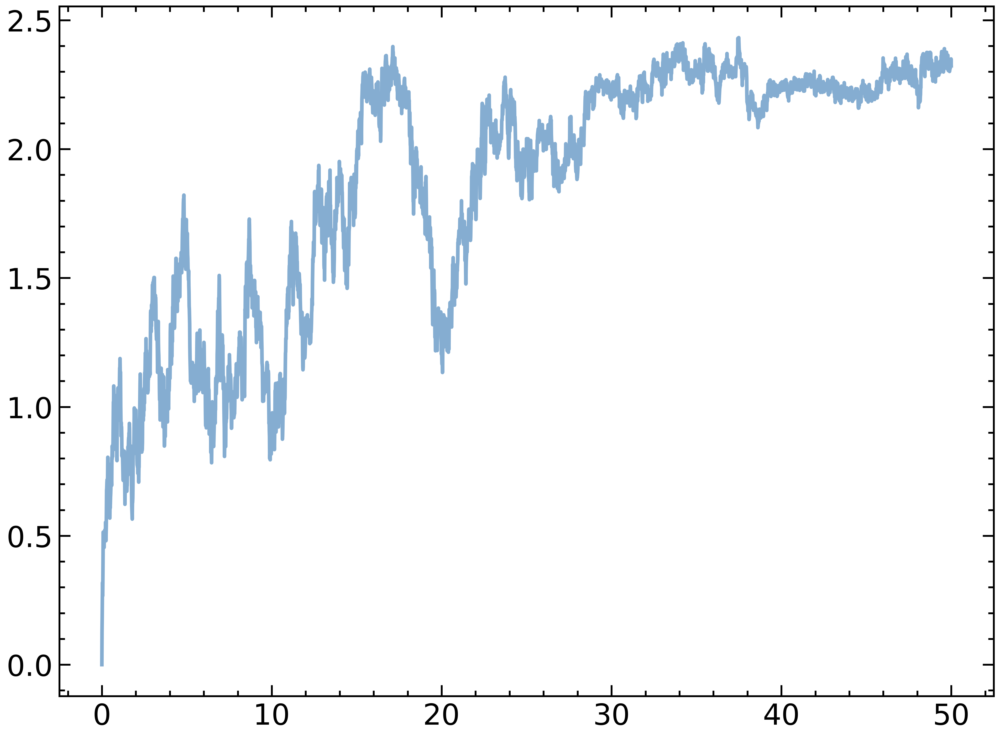

In [3]:
from MDAnalysis.analysis import rms

R = rms.RMSD(ku04amp01_folding,  # universe to align
    ku04amp01_folding,  # reference universe or atomgroup
    select='backbone',  # group to superimpose and calculate RMSD
    ref_frame=0)  # frame index of the reference

R.run(verbose=True)
times_c = R.results.rmsd[:,1]
rmsd_c = R.results.rmsd[:,2]
plt.plot(times_c/1000, rmsd_c/10, alpha=0.5)

## Radius of Gyration Calculation

  0%|          | 0/5001 [00:00<?, ?it/s]

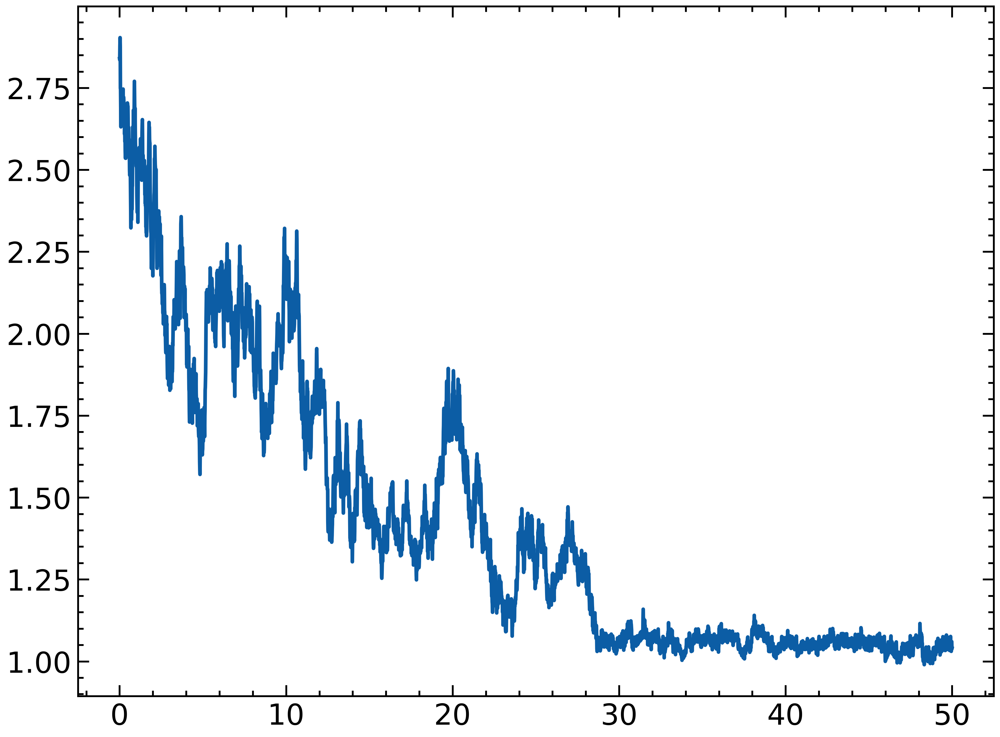

In [4]:
from tqdm.notebook import tqdm
group = ku04amp01_folding.select_atoms('protein')		# change the atom selection for your specific system

Frame = []
times = []
Rgyr = []
for ts in tqdm(ku04amp01_folding.trajectory):
	Frame.append(ts.frame)
	times.append(ku04amp01_folding.trajectory.time)
	Rgyr.append(group.radius_of_gyration())

Rgyrc_table = np.vstack((Frame, times, Rgyr)).T
plt.plot(Rgyrc_table[:,1]/1000, Rgyrc_table[:,2]/10)

## RMSF Calculation

Between protein backbone and Carbon alphas.

  0%|          | 0/5001 [00:00<?, ?it/s]

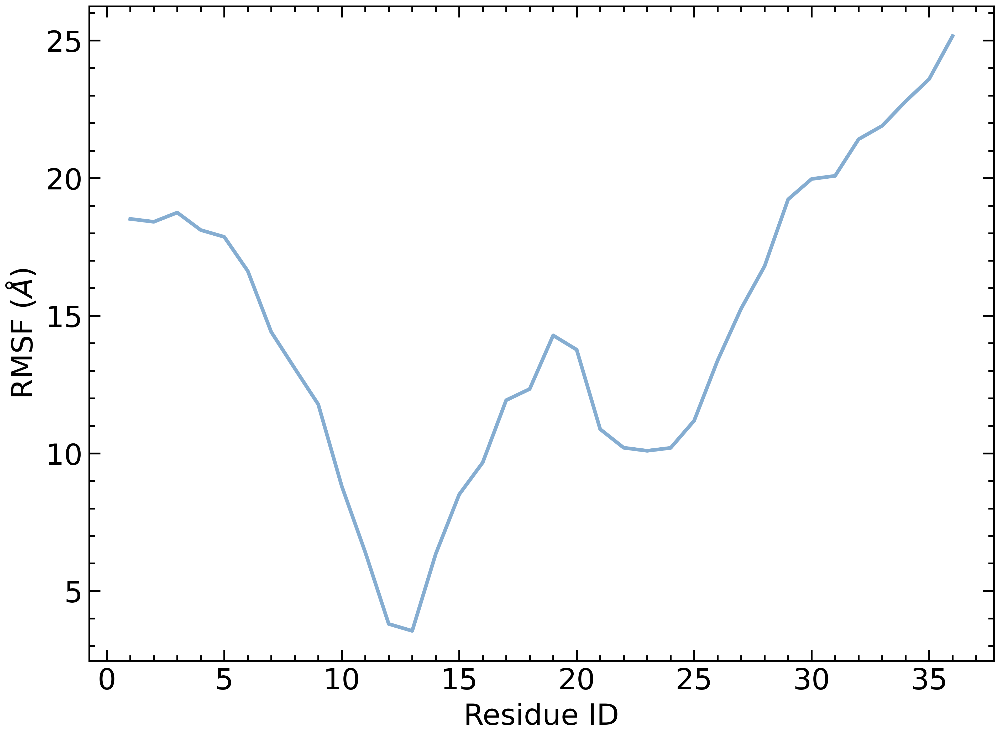

In [5]:
c_alphas_c = ku04amp01_folding.select_atoms('backbone and name CA')
R_c = rms.RMSF(c_alphas_c).run(verbose=True)
plt.xlabel('Residue ID')
plt.ylabel(r'RMSF $\left(\AA\right)$')
plt.plot(c_alphas_c.resids, R_c.results.rmsf, alpha=0.5)
plt.savefig('rmsf.png', dpi=600)

### Observations

Everything has stabilized after 30 ns. Residues 10-15 are relatively still.

## Plots

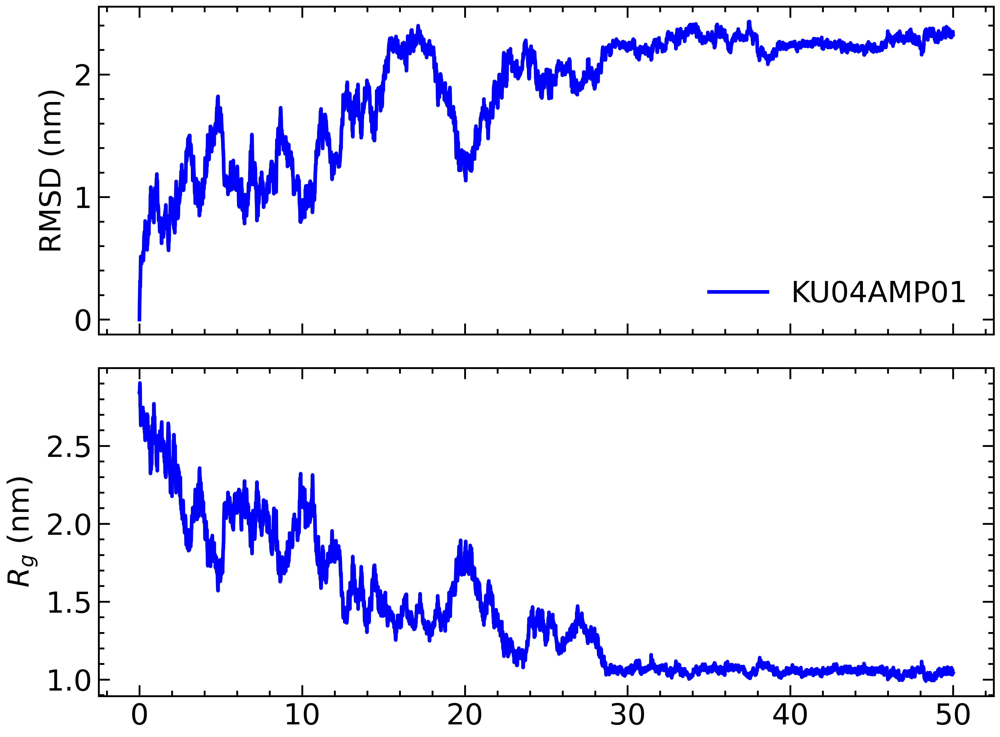

In [6]:
npanels = 2
fig, axs = plt.subplots(npanels,1, sharex=True, tight_layout=True)

ax_rmsd = axs[0]
ax_rmsd.set_ylabel(r'RMSD (nm)');


ax_rmsd.plot(times_c/1000, rmsd_c/10, label="KU04AMP01", 
        color='blue')

ax_rmsd.legend()

ax_rg = axs[1]

ax_rg.plot(Rgyrc_table[:,1]/1000, Rgyrc_table[:,2]/10, 
        label="Colpm-PEA", color='blue')
ax_rg.set_ylabel(r'$R_g$ (nm)');

plt.savefig("time-series-plots.png", dpi=600)
plt.show()

## Dihedral Angle Analysis

Ramchandran plots

In [36]:
from MDAnalysis.analysis.dihedrals import Ramachandran

residues = ku04amp01_folding.select_atoms('protein')

r = Ramachandran(residues).run()


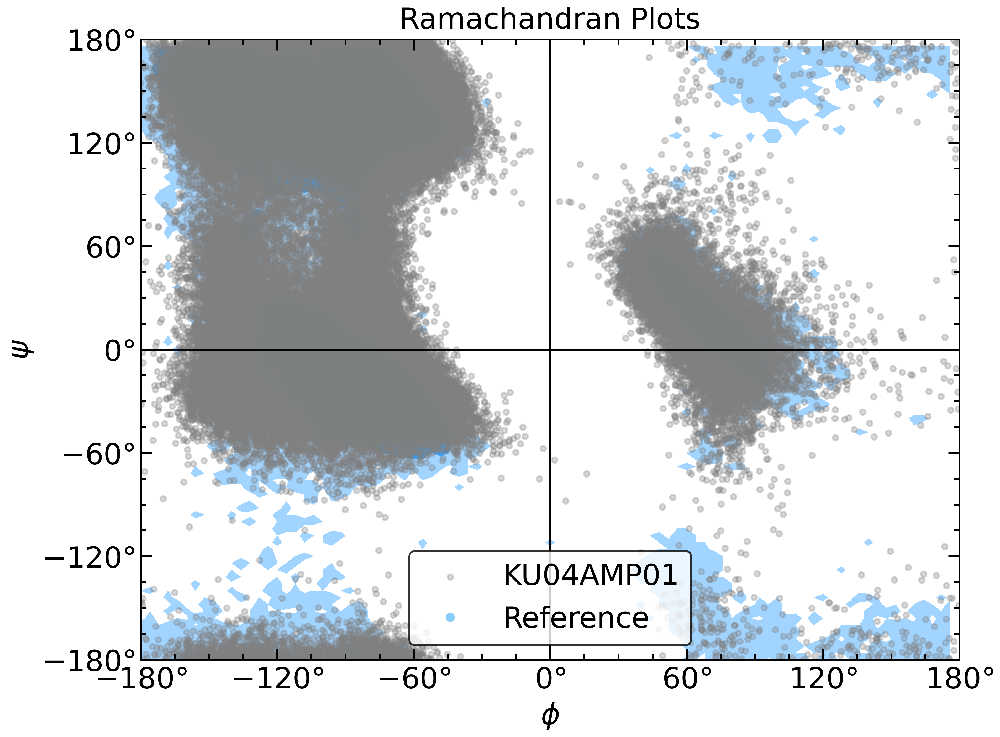

In [37]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
ax.set_title('Ramachandran Plots')
r.plot(ax=ax, ref=True, color='gray', marker='.', alpha=0.3, label='KU04AMP01')
ax.plot([], [], color='lightskyblue', marker='.', linestyle='None', markersize=8, label='Reference')
plt.rcParams['legend.frameon'] = True
plt.rcParams['legend.edgecolor'] = 'black'
plt.rcParams['legend.fancybox'] = True
ax.legend()
plt.savefig('ramachandran.png', dpi=600)

Identifying random coil conformations in a protein using a Ramachandran plot can be a bit tricky, as random coils do not have well-defined dihedral angles like structured regions. However, there are some general characteristics you can look for:

Scattered Points: Random coil regions are characterized by a lack of regular structure, so their φ (phi) and ψ (psi) angles will be more dispersed and scattered across the plot, rather than clustering in specific regions.

Absence of Clusters: Unlike alpha helices and beta sheets, which form distinct clusters in the allowed regions, random coils do not form such clusters. Instead, their angles may be distributed more evenly across the plot.

Allowed Regions: While random coils can have dihedral angles that fall within the allowed regions, they do not exhibit the tight clustering seen in secondary structures. You may see points within the alpha-helical or beta-sheet regions, but they won't be as concentrated.

Flexible Regions: Random coil regions are typically associated with higher flexibility, which can be reflected in the variability of their dihedral angles. These regions may show a wide range of φ and ψ values.

Here's a quick summary of what to look for:

Random coil: Scattered points, absence of clusters, wide range of φ and ψ values.

## Principal Component Analysis 

We will do the PCA using `gromacs` tools. Tentative comparison yields quantitatively better results for `gromacs` than `MDAnalysis`.

***Notabene*** MUST USE BACKBONE AND LIGAND AS SELECTIONS, SINCE WE NEED TO LOOK AT LIGAND CONFORMATIONAL CHANGES AS WELL.


### PCA via GROMACS tools

Go to the `sys_prod` directory, then create an index for backbone, ligand 

`gmx make_ndx -f prod_ku04amp01_linear.gro -o prod_ku04amp01_linear_pca.ndx` Choose backbone 
Then, we need to dump the first frame of MD simulation as pdb file (unless that has already been done).

Then, generating the eigenvectors

`gmx covar -s start.pdb -f prod_ku04amp01_linear_compact_compact.xtc -o prod_ku04amp01_linear_eigenvalues.xvg -v prod_ku04amp01_linear_eigenvectors.trr -xpma prod_ku04amp01_linear_covapic.xpm -n prod_ku04amp01_linear_pca.ndx`


Selections should be the index just created.

Followed by `gmx anaeig` to generate pc1, pc2 and pc3 files

`gmx anaeig -f prod_ku04amp01_linear_compact_compact.xtc -s start.pdb -v prod_ku04amp01_linear_eigenvectors.trr -last 1 -proj prod_ku04amp01_linear_pc1.xvg -n prod_ku04amp01_linear_pca.ndx`

`gmx anaeig -f prod_ku04amp01_linear_compact_compact.xtc -s start.pdb -v prod_ku04amp01_linear_eigenvectors.trr -first 2 -last 2 -proj prod_ku04amp01_linear_pc2.xvg -n prod_ku04amp01_linear_pca.ndx`

`gmx anaeig -f prod_ku04amp01_linear_compact_compact.xtc -s start.pdb -v prod_ku04amp01_linear_eigenvectors.trr -first 3 -last 3 -proj prod_ku04amp01_linear_pc3.xvg -n prod_ku04amp01_linear_pca.ndx`


Use these three xvg files (`prod_ku04amp01_linear_pc{1,2,3}.xvg`) to generate the following plots.

In [1]:
import numpy as np

# Function to read XVG file with skip header option
def read_xvg(file_path, skip_header):
    data = []
    with open(file_path, 'r') as file:
        lines = file.readlines()
        for line in lines[skip_header:]:
            if '&' in line:
                break
            else:
                data.append([float(val) for val in line.split()])
    data = np.array(data)
    return data[:, 0], data[:, 1]

# File paths for RMSD and radius of gyration XVG files
pc1_file = 'ku04amp01_linear/sys_prod/prod_ku04amp01_linear_pc1.xvg'
pc2_file = 'ku04amp01_linear/sys_prod/prod_ku04amp01_linear_pc2.xvg'
pc3_file = 'ku04amp01_linear/sys_prod/prod_ku04amp01_linear_pc3.xvg'

# Read data from XVG files with skip headers
t1, pc1_data = read_xvg(pc1_file, skip_header=24)  # Adjust skip_header based on your file format
t2, pc2_data = read_xvg(pc2_file, skip_header=24)  # Adjust skip_header based on your file format
t2, pc3_data = read_xvg(pc3_file, skip_header=24)  # Adjust skip_header based on your file format

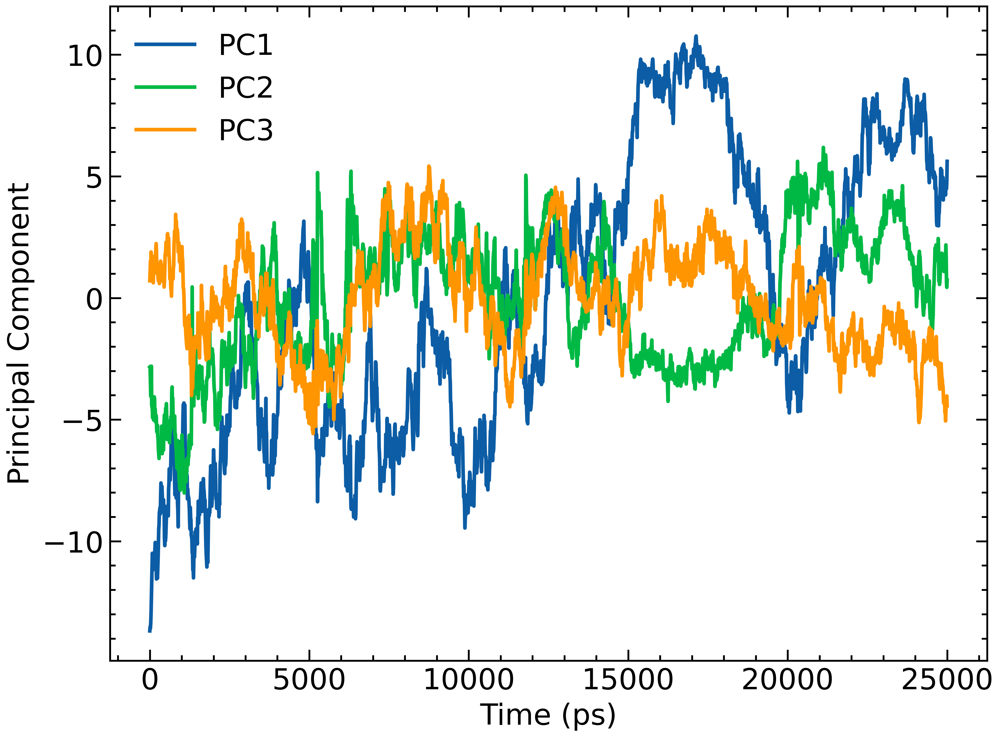

In [2]:
import matplotlib.pyplot as plt
import scienceplots
plt.style.use(['science','notebook'])
plt.plot(t1, pc1_data, label='PC1')
plt.plot(t2, pc2_data, label='PC2')
plt.plot(t2, pc3_data, label='PC3')
plt.xlabel('Time (ps)')
plt.ylabel('Principal Component')
plt.legend()

For PCA with respect to energy, first

```bash
paste prod_ku04amp01_linear_pc1.xvg prod_ku04amp01_linear_pc2.xvg | awk '{print $1, $2, $4}' > prod_ku04amp01_linear_pc1pc2.xvg

paste prod_ku04amp01_linear_pc2.xvg prod_ku04amp01_linear_pc3.xvg | awk '{print $1, $2, $4}' > prod_ku04amp01_linear_pc2pc3.xvg

paste prod_ku04amp01_linear_pc3.xvg prod_ku04amp01_linear_pc1.xvg | awk '{print $1, $2, $4}' > prod_ku04amp01_linear_pc3pc1.xvg
```

Then, use these PCIPCJ.xvg files to generate xpm files

```bash

gmx sham -f prod_ku04amp01_linear_pc1pc2.xvg -ls prod_ku04amp01_linear_FES12.xpm
gmx sham -f prod_ku04amp01_linear_pc2pc3.xvg -ls prod_ku04amp01_linear_FES23.xpm
gmx sham -f prod_ku04amp01_linear_pc3pc1.xvg -ls prod_ku04amp01_linear_FES31.xpm

```

Then use the following `xpm2txt.py` script to convert the .xpm file into .dat file:


In [ ]:
%%script true
#!/usr/bin/env python3

import sys

"""
Utility tool to convert xpm files generated by GROMACS to a 3-column text file.
"""

USAGE = "USAGE: xpm2txt.py -f <input xpm file> -o <output txt file> [-s]\n"
USAGE += "Options:\n"
USAGE += "\t-s\t(int)\tSorts the output by a given column"
USAGE += "\n"  # always keep this line

# Parse arguments
read_input, read_output, sort = False, False, False
xpm_file, out_file, column_sort = None, None, None
for arg in sys.argv[1:]:
    if read_input:
        read_input = False
        xpm_file = arg
    elif read_output:
        read_output = False
        out_file = arg
    elif sort:
        sort = False
        column_sort = int(arg)
    if arg.startswith("-"):
        if arg == "-f":
            read_input = True
            continue
        elif arg == "-o":
            read_output = True
            continue
        elif arg == "-s":
            sort = True
        else:
            print(USAGE)
            sys.stderr.write('ERROR: Option not recognized: %s\n' % arg)
            sys.exit(1)

if not xpm_file:
    print(USAGE)
    sys.stderr.write('ERROR: You forgot to provide an input file.\n')
    sys.exit(1)
if not out_file:
    out_file = "out.txt"

# Parse XPM file
with open(xpm_file) as xpm_handle:
    xpm_data = []
    x_axis, y_axis = [], []
    letter_to_value = {}
    for line in xpm_handle:
        if line.startswith("/* x-axis"):
            x_axis = list(map(float, line.split()[2:-2]))  # We trim the last value

        if line.startswith("/* y-axis"):
            y_axis = list(map(float, line.split()[2:-2]))  # We trim the last value

        if line.startswith('"') and x_axis and y_axis:  # Read data
            xpm_data.insert(0, line.strip().strip(',')[1:-1])

        if line.startswith('"') and len(line.split()) > 4:
            letter = line.split()[0][1:]
            value = float(line.split()[-2][1:-1])
            letter_to_value[letter] = value

# Match x/y/data
txt_values = []
for y_index, data_value in enumerate(xpm_data):
    y_value = y_axis[y_index]
    for x_index, x_value in enumerate(x_axis):
        txt_values.append([x_value, y_value, letter_to_value[data_value[x_index]]])

# Apply sorting if requested
if column_sort:
    try:
        txt_values.sort(key=lambda x: x[column_sort - 1])
    except IndexError:
        print(USAGE)
        sys.stderr.write('ERROR: Column not found (%s)\n' % (column_sort))
        sys.exit(1)

# Print to file
with open(out_file, 'w') as out_handle:
    for x, y, z in txt_values:
        out_handle.write("%3.5f\t%3.5f\t%3.5f\n" % (x, y, z))

Use this above-mentioned script as

```bash
./xpm2txt.py -f prod_ku04amp01_linear_FES12.xpm -o prod_ku04amp01_linear_FEL12.dat
./xpm2txt.py -f prod_ku04amp01_linear_FES23.xpm -o prod_ku04amp01_linear_FEL23.dat
./xpm2txt.py -f prod_ku04amp01_linear_FES31.xpm -o prod_ku04amp01_linear_FEL31.dat
```

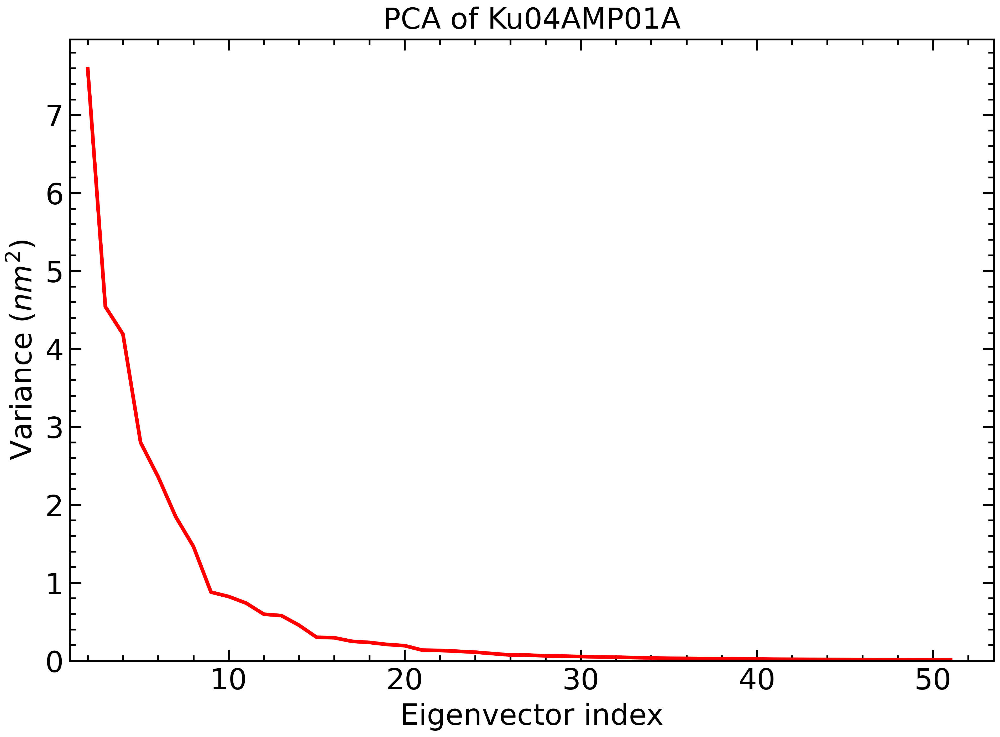

In [3]:
import matplotlib.pyplot as plt
import numpy as np

# Read input data from a file
input_file = 'ku04amp01_linear/sys_prod/prod_ku04amp01_linear_FEL12.dat'
data = np.loadtxt(input_file)  # Assuming input data file ha6s PC1, PC2, and hbonds columns

PC12_1 = data[:, 0]
PC12_2 = data[:, 1]
free_energy_12 = data[:, 2]/4.184  # Convert kJ/mol to kcal/mol


input_file = 'ku04amp01_linear/sys_prod/prod_ku04amp01_linear_FEL23.dat'
data = np.loadtxt(input_file)  # Assuming input data file ha6s PC1, PC2, and hbonds columns

PC23_2 = data[:, 0]
PC23_3 = data[:, 1]
free_energy_23 = data[:, 2]/4.184  # Convert kJ/mol to kcal/mol

input_file = 'ku04amp01_linear/sys_prod/prod_ku04amp01_linear_FEL31.dat'
data = np.loadtxt(input_file)  # Assuming input data file ha6s PC1, PC2, and hbonds columns

PC31_3 = data[:, 0]
PC31_1 = data[:, 1]
free_energy_31 = data[:, 2]/4.184  # Convert kJ/mol to kcal/mol


# Function to read XVG file and extract data
def read_xvg(file_path):
    data = np.genfromtxt(file_path, skip_header=18)  # Adjust skip_header based on your XVG file format
    xpoints = data[:, 0]
    ypoints = data[:, 1]
    return xpoints, ypoints

# Replace these placeholders with your actual file paths
D1_path = 'ku04amp01_linear/sys_prod/prod_ku04amp01_linear_eigenvalues.xvg'

# Read data from XVG files
time_D1, D1_data = read_xvg(D1_path)

plt.plot(time_D1[0:50], D1_data[0:50], color='red')
plt.xlim(1, )
plt.ylim(0, )
plt.xlabel('Eigenvector index')
plt.ylabel(r'Variance $\left(nm^2\right)$')
plt.title('PCA of Ku04AMP01A');
plt.savefig("pca-ku04amp01.png", dpi=600)


### Notabene

The first three PCA eigenvector axes might not be enough, as the fourth has a cumulative eigenvalue comparable to the third. Doing FEL for all pairs of 4 axes is complex, however. Running the sim for longer might yield sharper drops in cululative eigenvalues.

In [10]:
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import scienceplots

import matplotlib.pyplot as plt
size = np.array([40,12])
plt.style.use(['science','notebook'])
fig = plt.figure(figsize=size)
fig.suptitle(r'Ku04AMP01 PCA: Free Energy Landscapes $\left(kcal\cdot mol^{-1}\right)$', fontsize=20)
# First subplot: free_energy_12 vs PC12
ax1 = fig.add_subplot(1, 3, 1, projection='3d')
ax1.plot_trisurf(PC12_1, PC12_2, free_energy_12, cmap='viridis', alpha=0.8)
ax1.set_xlabel(r'$PC_1\; (nm)$', labelpad=20)
ax1.set_ylabel(r'$PC_2\;(nm)$', labelpad=20)
ax1.scatter(PC12_1, PC12_2, c=free_energy_12, cmap='viridis', s=50, alpha=0.5)
ax1.scatter(pc1_data[0:100], pc2_data[0:100], 0, color='magenta', linewidth=4, label='Trajectory Start')
ax1.scatter(pc1_data[-100:-1], pc2_data[-100:-1], 0, color='red', linewidth=4, label='Trajectory End')
#ax1.legend()

# Second subplot: free_energy_23 vs PC23
ax2 = fig.add_subplot(1, 3, 2, projection='3d')
ax2.plot_trisurf(PC23_2, PC23_3, free_energy_23, cmap='viridis', alpha=0.8)
ax2.set_xlabel(r'$PC_2\; (nm)$', labelpad=20)
ax2.set_ylabel(r'$PC_3\; (nm)$', labelpad=20)
ax2.scatter(PC23_2, PC23_3, c=free_energy_23, cmap='viridis', s=50, alpha=0.5)
ax2.scatter(pc2_data[0:100], pc3_data[0:100], 0, color='magenta', linewidth=4, label='Trajectory Start')
ax2.scatter(pc2_data[-50:-1], pc3_data[-50:-1], 0, color='red', linewidth=4, label='Trajectory End')

# Third subplot: free_energy_31 vs PC31
ax3 = fig.add_subplot(1, 3, 3, projection='3d')
ax3.plot_trisurf(PC31_1, PC31_3, free_energy_31, cmap='viridis', alpha=0.8)
ax3.set_xlabel(r'$PC_3\; (nm)$', labelpad=20)
ax3.set_ylabel(r'$PC_1\; (nm)$', labelpad=20)
ax3.scatter(PC31_1, PC31_3, c=free_energy_31, cmap='viridis', s=50, alpha=0.5)
ax3.scatter(pc1_data[0:500], pc3_data[0:500], 0, color='magenta', linewidth=4, label='Trajectory Start')
ax3.scatter(pc1_data[-100:-1], pc3_data[-100:-1], 0, color='red', linewidth=4, label='Trajectory End')

for ax in [ax1, ax2, ax3]:
    ax.yaxis.set_tick_params(pad=10)
    ax.set_zticks([0, 1, 2, 3, 4])

ax1.view_init(elev=30, azim=120)
ax2.view_init(elev=15, azim=210)
ax3.view_init(elev=15, azim=300)

ax1.zaxis.set_tick_params(pad=10)
ax2.set_zticklabels([])
ax3.set_zticklabels([])
plt.savefig("pca-free-energy.svg", dpi=600)
ax2.legend()
plt.tight_layout()
plt.show()

/tmp/ipykernel_2194256/4275779738.py:49: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.savefig("pca-free-energy.svg", dpi=600)


### PCA Conclusion 

There is good clustering at the end, suggesting equilibration.

Finally, I ran the following commands to project the trajectory to the PCA components and then visualize them.

`gmx anaeig -f prod_ku04amp01_linear_compact_compact.xtc -s start.pdb -extr extreme_pc.pdb -first 1 -last 3 -n prod_ku04amp01_linear_pca.ndx -nframes 80 -v prod_ku04amp01_linear_eigenvectors.trr`

Then load the three pdbs of the projections along each axis into pymol and made the following observations. The image corroborates the PCA FEL plots in that the ligand shoots out of the protein and leaves.


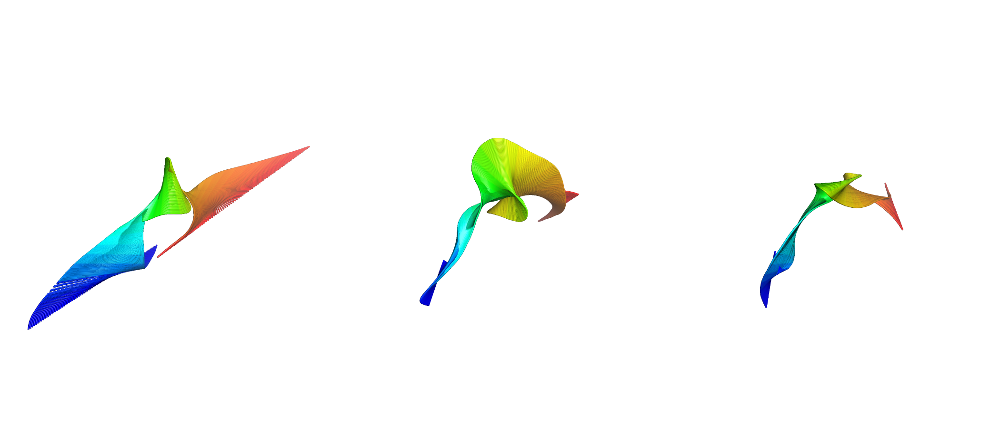

In [11]:
from IPython.display import Image
Image("pc1pc2pc3.png")